![Alt text](imgex-1.jpg)

#### This notbook show some Albumentation augaugmentation transforms used to preprocess images in image classification tasks

### What Albumentation
#### Albumentations is a powerful open-source image augmentation library created in June 2018 by a group of researchers and engineers, including Alexander Buslaev, Vladimir Iglovikov, and Alex Parinov. The library was designed to provide a flexible and efficient framework for data augmentation in computer vision tasks.

### Albumentation Documentation:
#### https://albumentations.ai/docs/api_reference/augmentations/
#### https://albumentations.ai/docs/getting_started/image_augmentation/
#### https://albumentations.ai/docs/examples/example/
### Albumentation GitHub:
#### https://github.com/albumentations-team/



In [1]:
import random

import cv2
from matplotlib import pyplot as plt
import os
import albumentations as A

## simple example
### We can divide the process of image augmentation into four steps:

#### 1.Import albumentations and a library to read images from the disk (e.g., OpenCV).
#### 2.Define an augmentation pipeline.
#### 3.Read images from the disk.
#### 4.Pass images to the augmentation pipeline and receive augmented images.

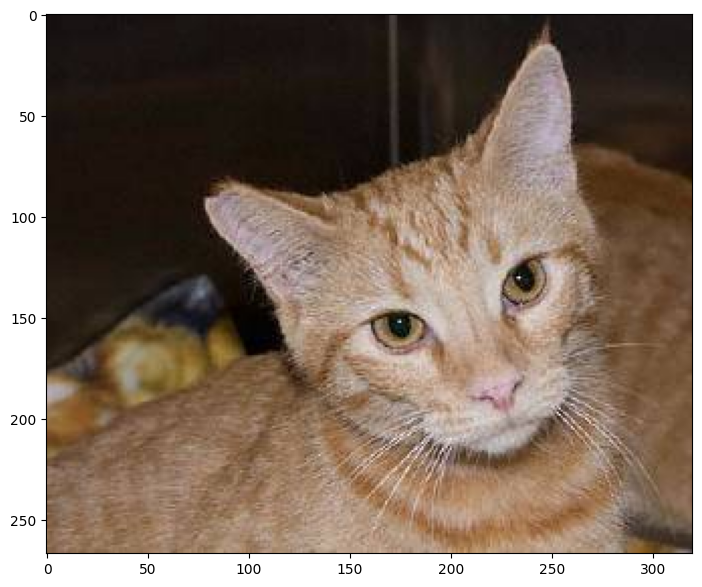

In [2]:
# read image
img = cv2.imread('data/cat.14.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,7))
plt.imshow(img)

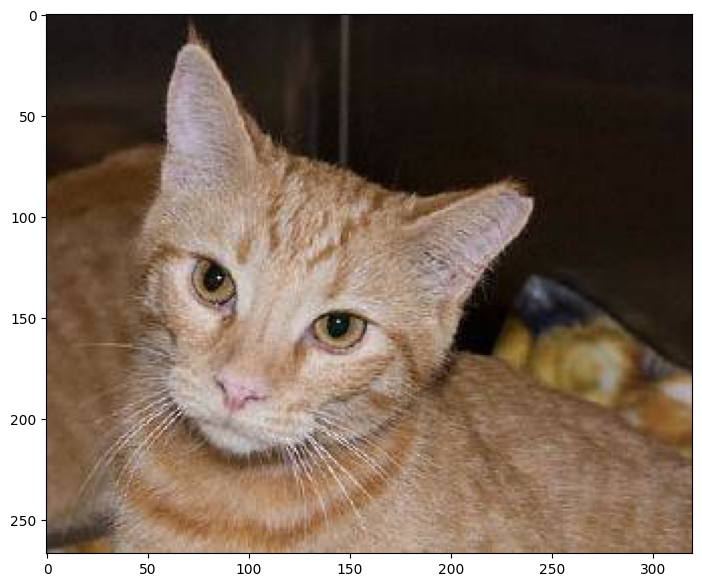

In [3]:
# define transform 
tr=A.HorizontalFlip(p=0.5)
# apply transform
# transform will return a dictionary with a single key image. Value at that key will contain an augmented image.
img_t=tr(image=img)["image"]
# show image after apply transform
plt.figure(figsize=(10,7))
plt.imshow(img_t)

### previous example apply single transform on image, To define an augmentation pipeline, you need to create an instance of the Compose class. As an argument to the Compose class, you need to pass a list of augmentations you want to apply.

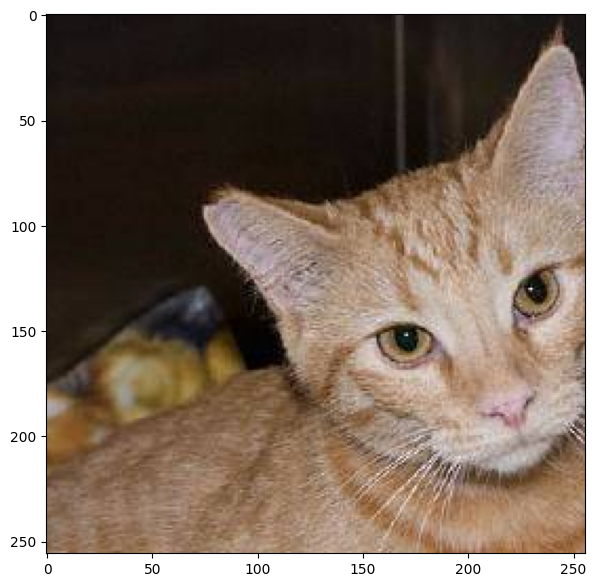

In [4]:
# In the example, Compose receives a list with three augmentations: A.RandomCrop, A.HorizontalFlip, and A.RandomBrighntessContrast.
tr = A.Compose([
    A.RandomCrop(width=256, height=256),
    A.HorizontalFlip(p=0.7),
    A.RandomBrightnessContrast(p=0.5),
])
img_t=tr(image=img)["image"]
# show image after apply transform
plt.figure(figsize=(10,7))
plt.imshow(img_t)

### define function to visualize images

In [5]:
def visualize_multi_images(rows, cols, imgs, figsize=(10, 6),labels=[]):
    plt.figure(figsize=figsize)  # Set the figure size
    for num, img in enumerate(imgs):
        plt.subplot(rows, cols, num + 1)
        plt.axis('off')
        if labels:
            plt.title(labels[num])
        plt.imshow(img)
    plt.show()

### read images 

In [6]:
imgs_org=[]
for i in os.listdir('data/'):
    img = cv2.imread('data/'+i)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    imgs_org.append(img)

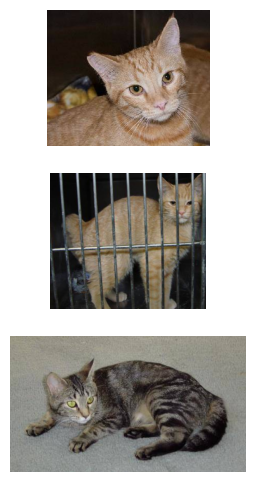

In [7]:
visualize_multi_images(len(imgs_org),1,imgs_org)

### define function apply transform on images 

In [8]:
def apply_transform(transform):
    imgs=[]
    for i in os.listdir('data/'):
        img = cv2.imread('data/'+i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        img=transform(image=img)['image']
        imgs.append(img)
    return imgs

### example

org:


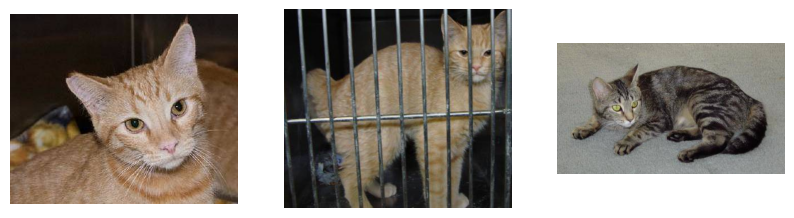

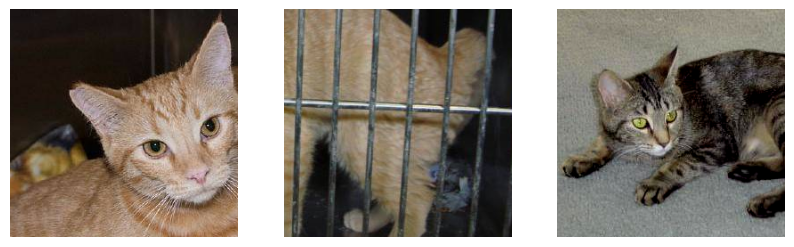

In [9]:
transform = A.Compose([
    A.RandomCrop(width=256, height=256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
])
imgs=apply_transform(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(1,len(imgs),imgs)


### p is a special parameter that is supported by almost all augmentations. It controls the probability of applying the augmentation.
### If you want apply specific transform always pass 'True' to 'always_apply' parameter or set p with 1.

### define function to apply transform on each image 5 times

In [10]:
def apply_transform_multi(transform):
    imgs=[]
    for i in os.listdir('data/'):
        img = cv2.imread('data/'+i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        for _ in range(5):
            img_t=transform(image=img)['image']
            imgs.append(img_t)
            
    return imgs


### example

org:


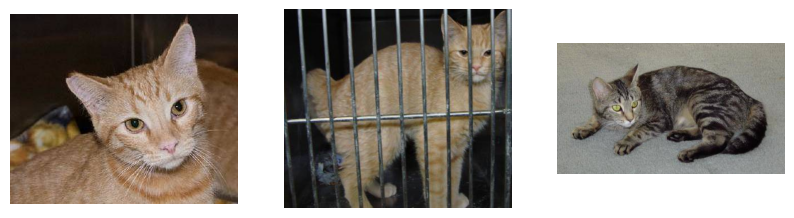

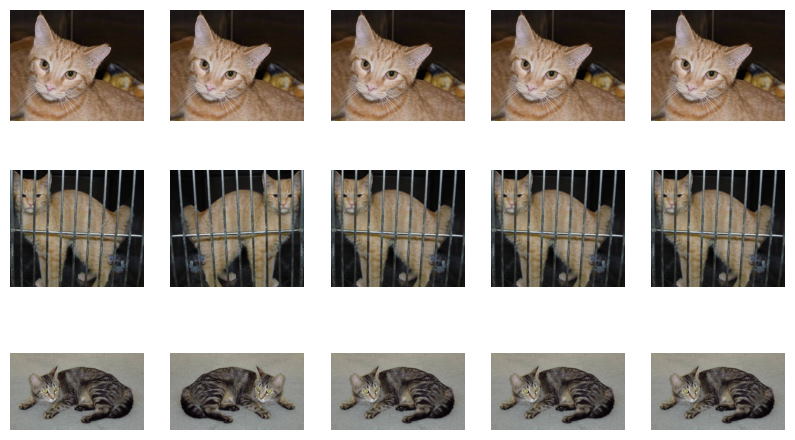

In [11]:
transform = A.HorizontalFlip(p=0.7)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs)


## Topics:
### Some Transformations
#### 1.Blurring
#### 2.Crop
#### 3.Dropout
#### 4.Geometric
#### 5.Other transforms
### With Pytorch

## 1.Blurring
###  We use Blurring  to reduce image noise and reduce detail. It used as a preprocessing stage before applying our machine learning or deep learning models.
### Docs: https://albumentations.ai/docs/api_reference/augmentations/blur/ 

### Blur 

org:


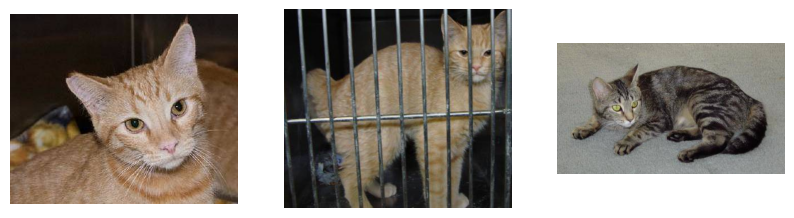

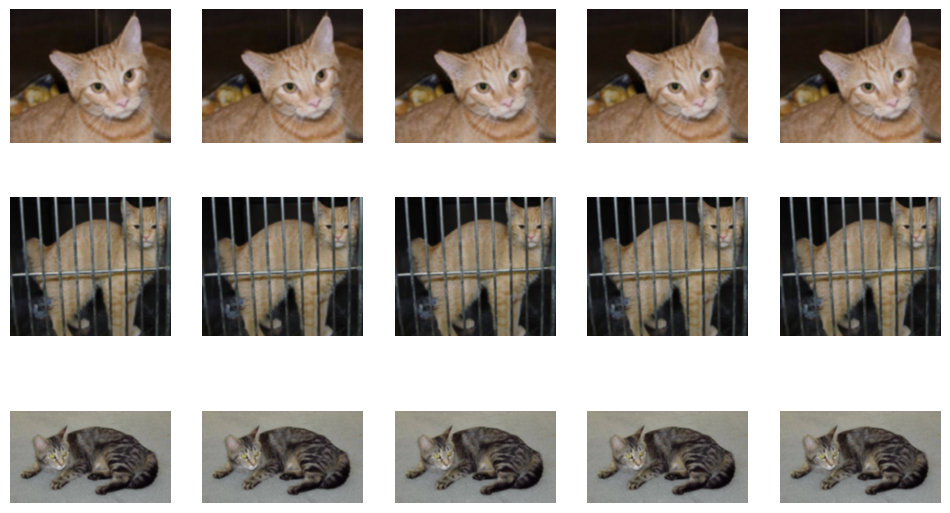

In [12]:
transform = A.Blur(blur_limit=(5,5),always_apply=True)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### Defocus

org:


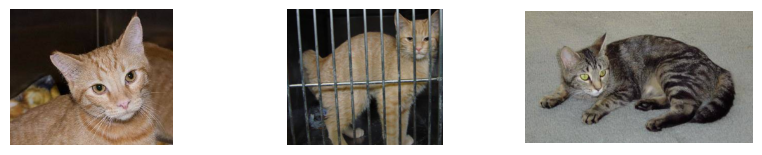

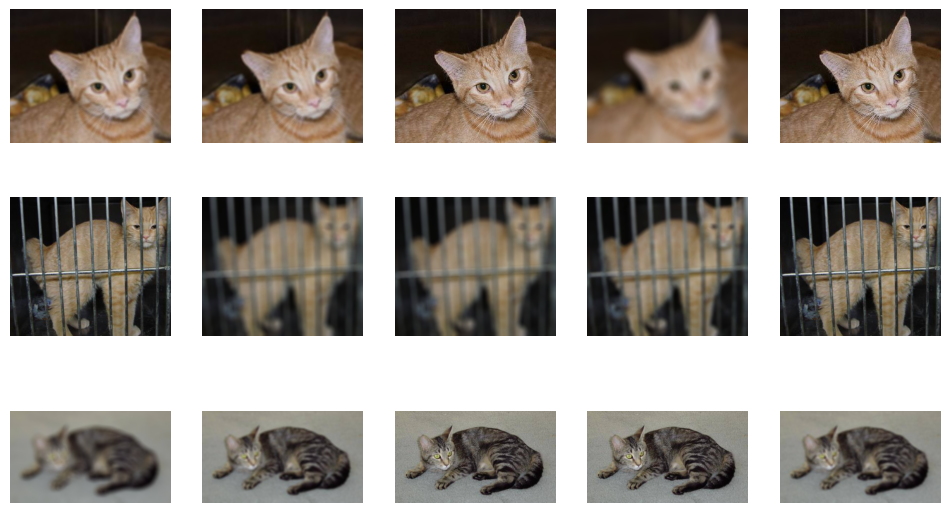

In [13]:
transform = A.Defocus(p=0.5)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(len(imgs_org),3,imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### GaussianBlur

org:


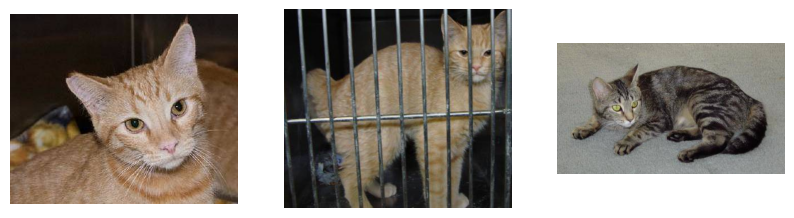

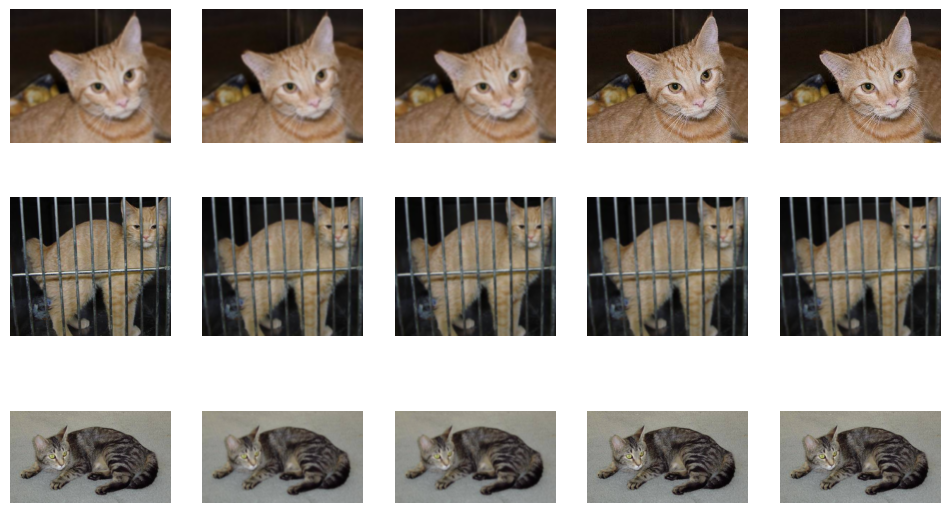

In [14]:
transform = A.GaussianBlur (blur_limit=(9,9),p=0.6)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


## 2.Crop
###  Cropping is simple method is to crop images to remove unwanted outer areas.
### Docs: https://albumentations.ai/docs/api_reference/augmentations/crops/

### CenterCrop

org:


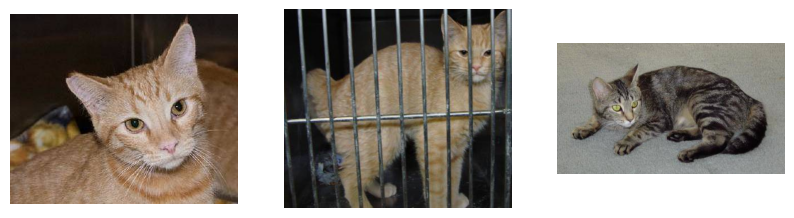

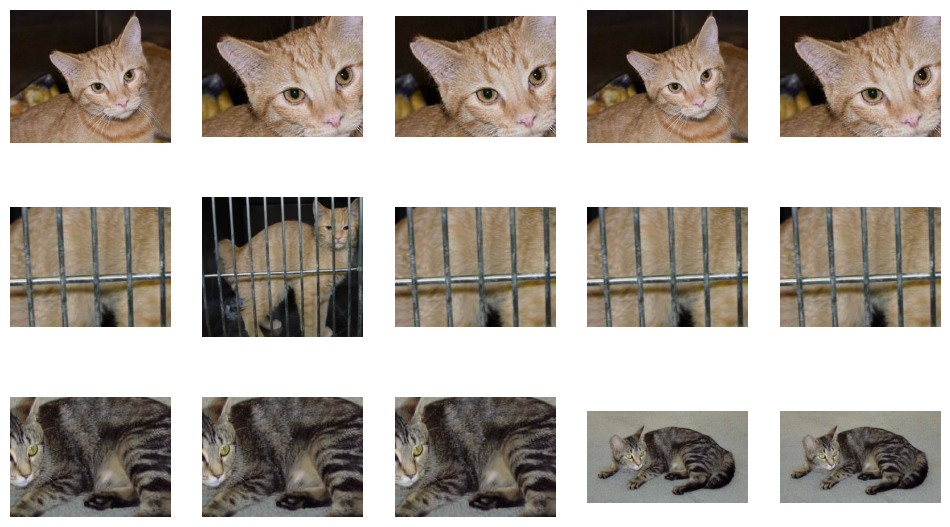

In [15]:
transform = A.CenterCrop(150,200,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### Crop

org:


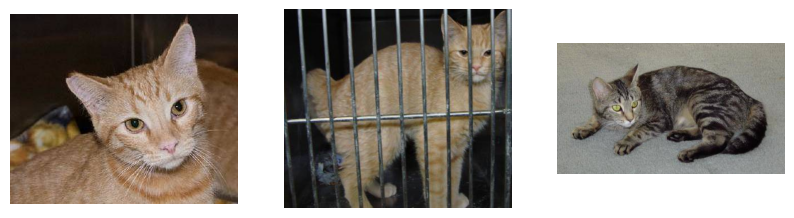

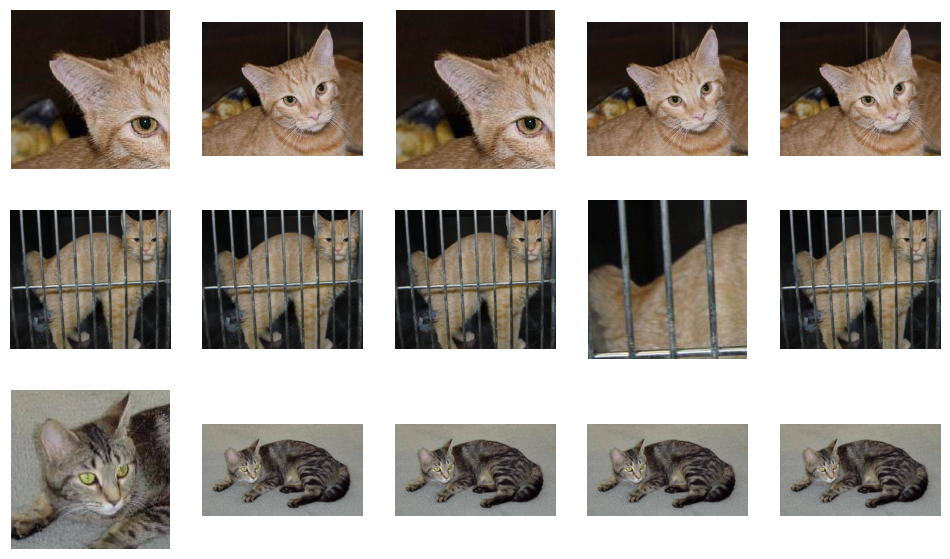

In [16]:
transform = A.Crop(40,40,200,200,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### CropAndPad

org:


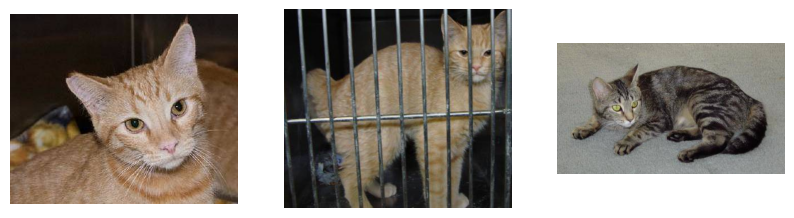

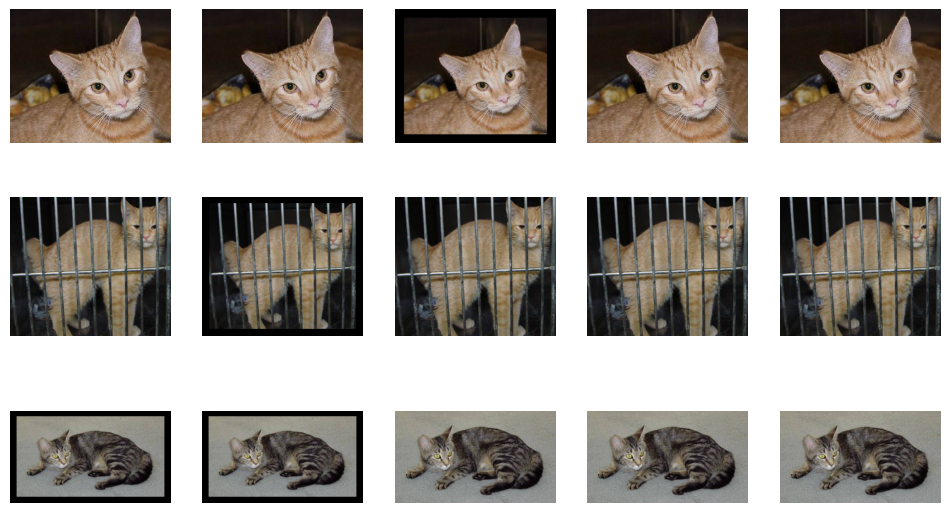

In [17]:
transform = A.CropAndPad(px=20,pad_mode=cv2.BORDER_CONSTANT,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


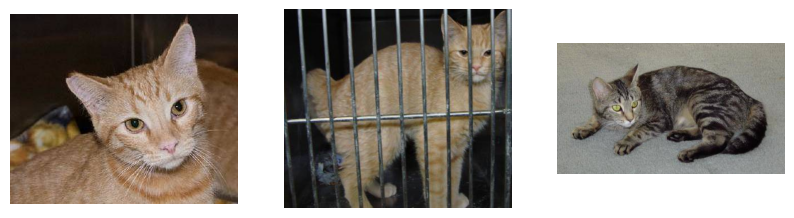

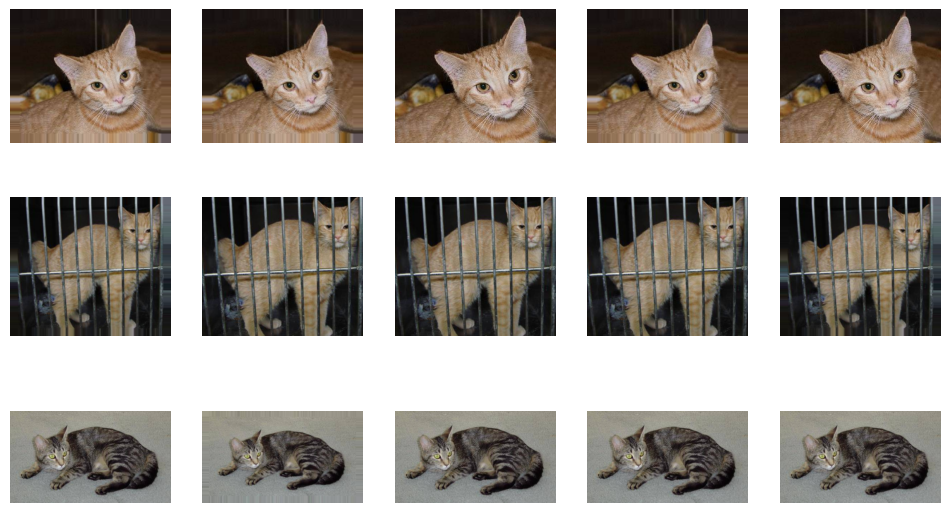

In [18]:
transform = A.CropAndPad(px=20,pad_mode=cv2.BORDER_REPLICATE,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


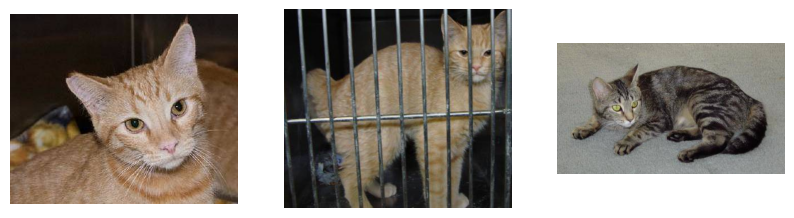

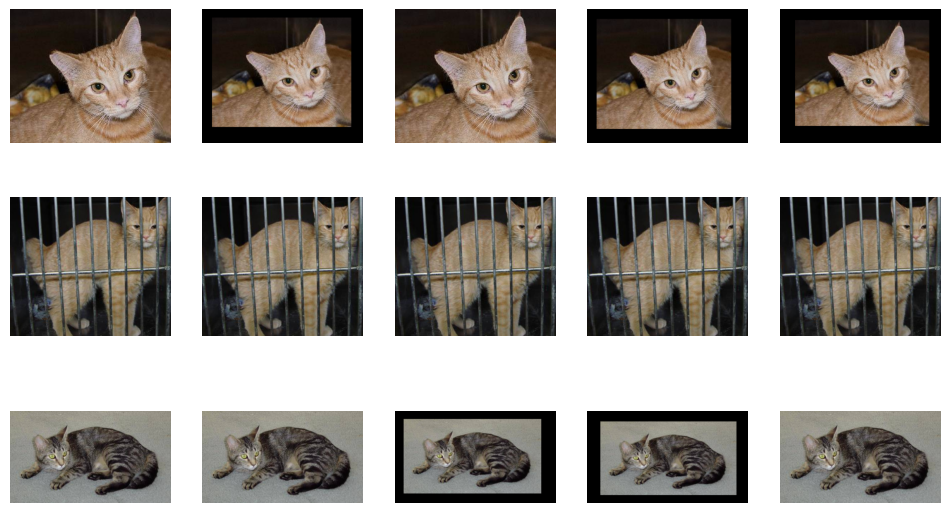

In [19]:
transform = A.CropAndPad(px=[20,50],pad_mode=cv2.BORDER_CONSTANT,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


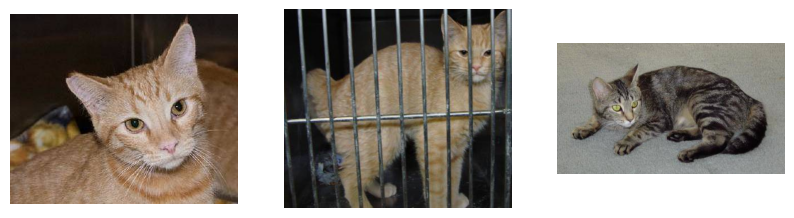

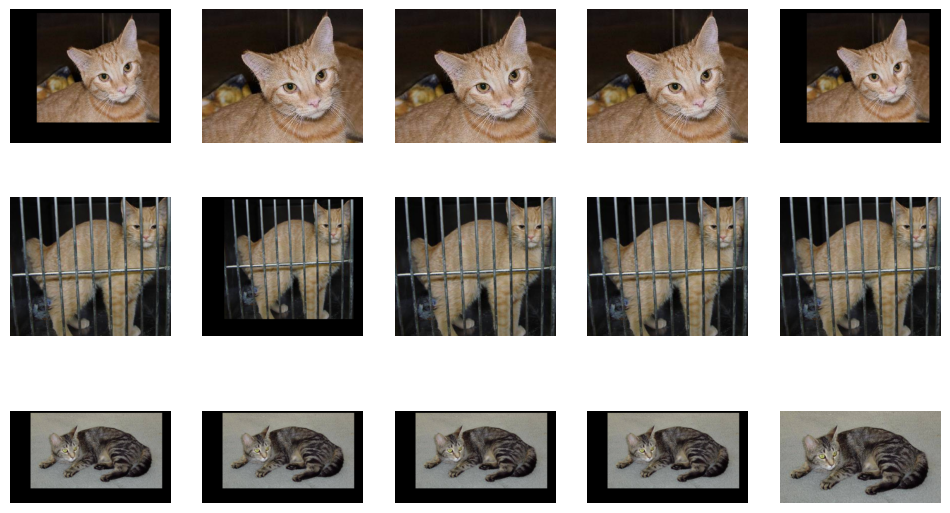

In [20]:
transform = A.CropAndPad(px=[10,30,50,70],pad_mode=cv2.BORDER_CONSTANT,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


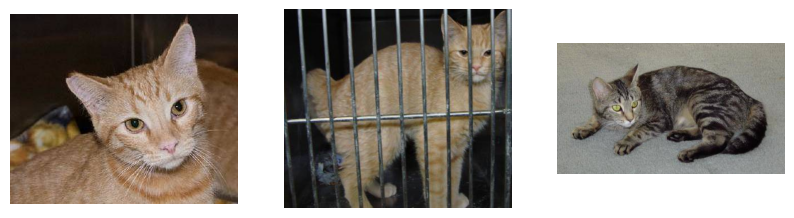

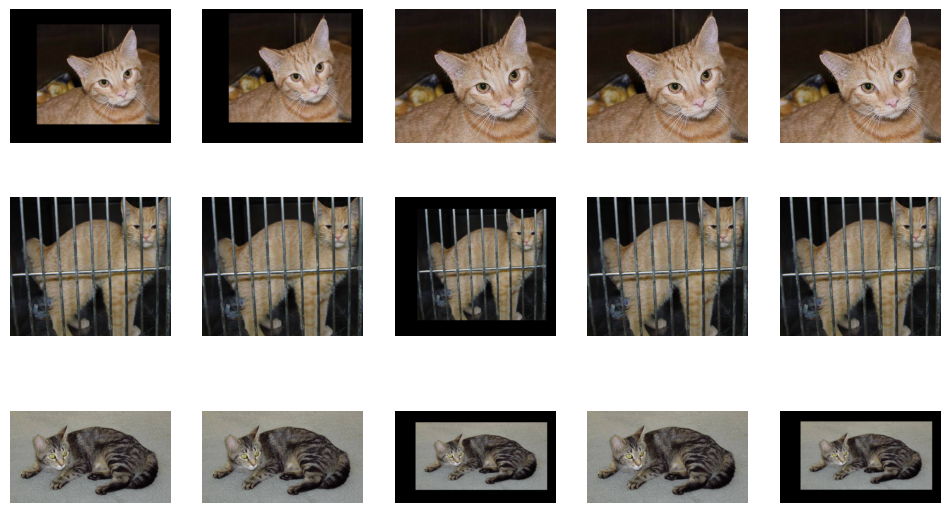

In [21]:
transform = A.CropAndPad(px=[[10,50],30,50,70],pad_mode=cv2.BORDER_CONSTANT,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


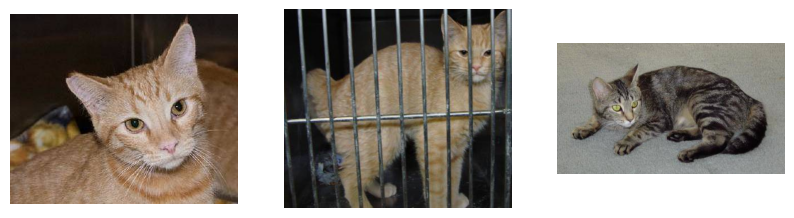

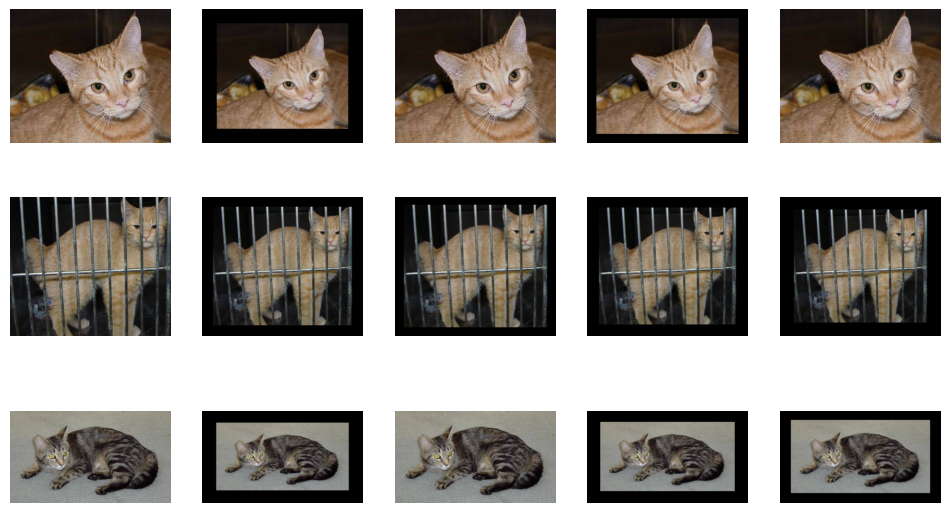

In [22]:
transform = A.CropAndPad(px=[20,50],pad_mode=cv2.BORDER_CONSTANT,sample_independently=False,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


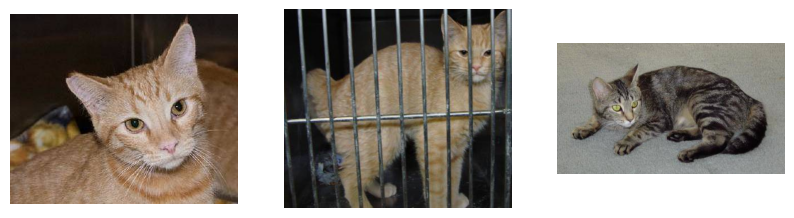

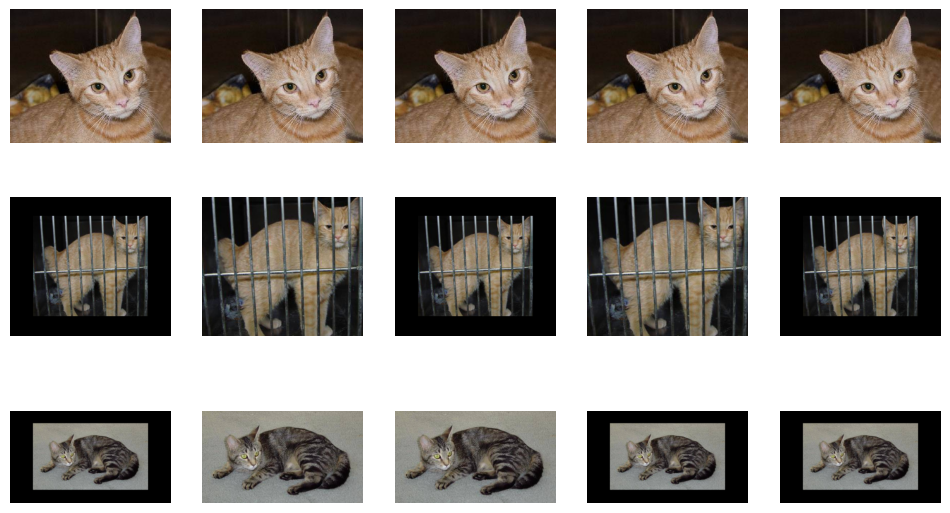

In [23]:
transform = A.CropAndPad(percent=0.2,pad_mode=cv2.BORDER_CONSTANT,pad_cval=0,keep_size=True,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### RandomCrop

org:


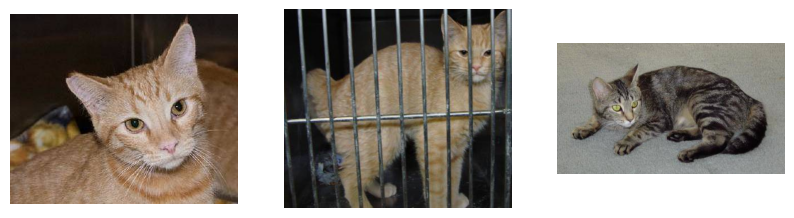

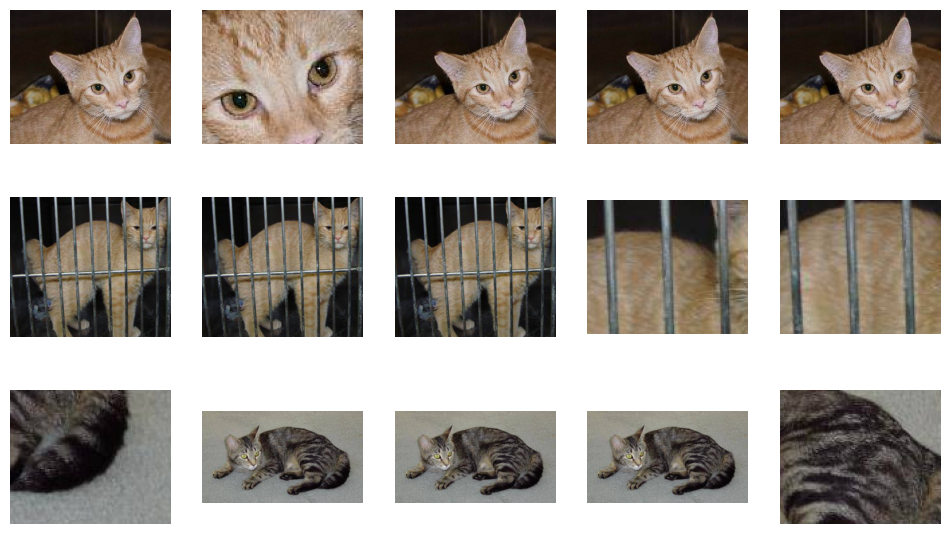

In [24]:
transform = A.RandomCrop(100,120,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### RandomResizedCrop

org:


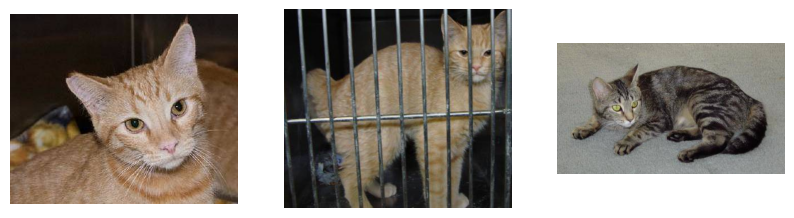

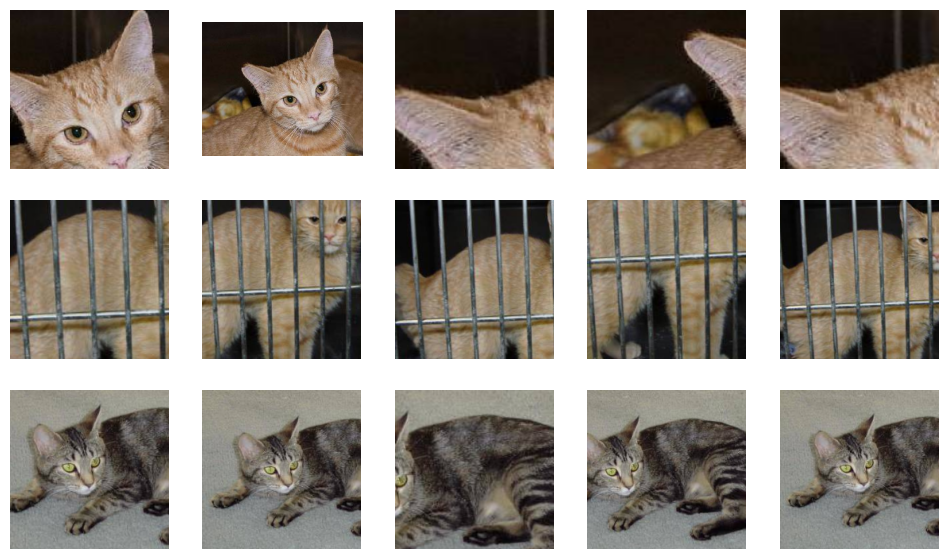

In [25]:
transform = A.RandomResizedCrop(200,200,scale=[0.1,0.6],ratio=[0.77,1.0],p=0.7)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### RandomSizedCrop

org:


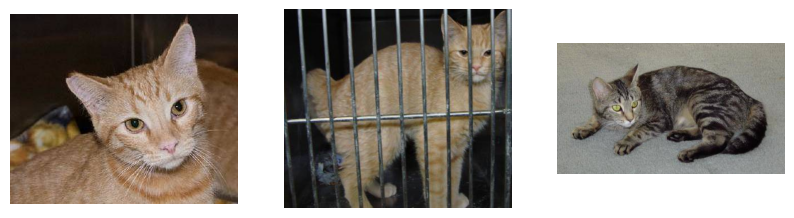

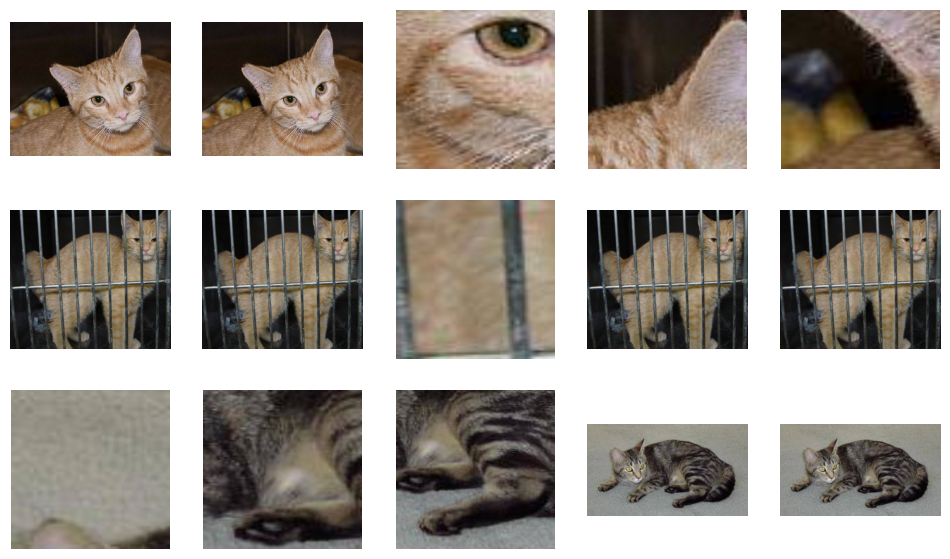

In [26]:
transform = A.RandomSizedCrop([60,150],height=200,width=200,w2h_ratio=0.8,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



## DropOut
### Drop specific channel or 
### Docs: https://albumentations.ai/docs/api_reference/augmentations/dropout/

### ChannelDropout

org:


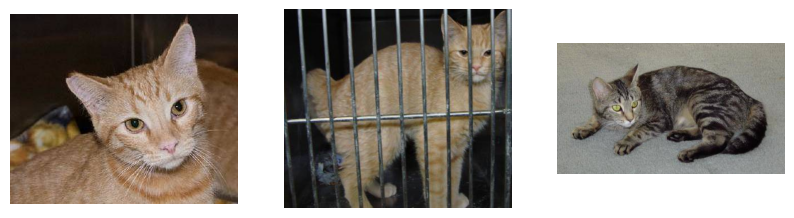

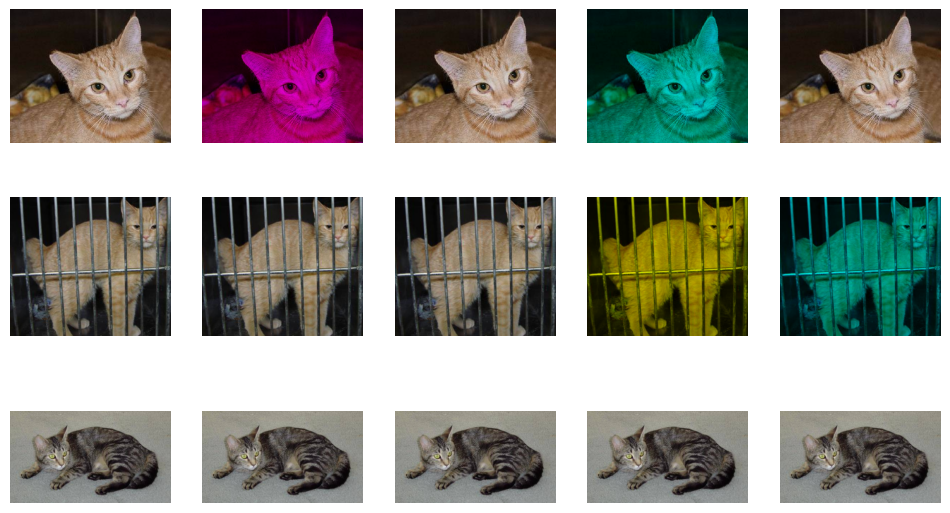

In [27]:
transform = A.ChannelDropout(channel_drop_range=[1,1],fill_value=0,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### Cutout

c:\Users\Hassan\AppData\Local\Programs\Python\Python38\lib\site-packages\albumentations\augmentations\dropout\cutout.py:49: FutureWarning: Cutout has been deprecated. Please use CoarseDropout
  warnings.warn(


org:


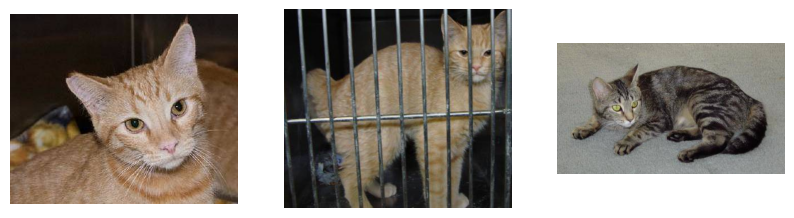

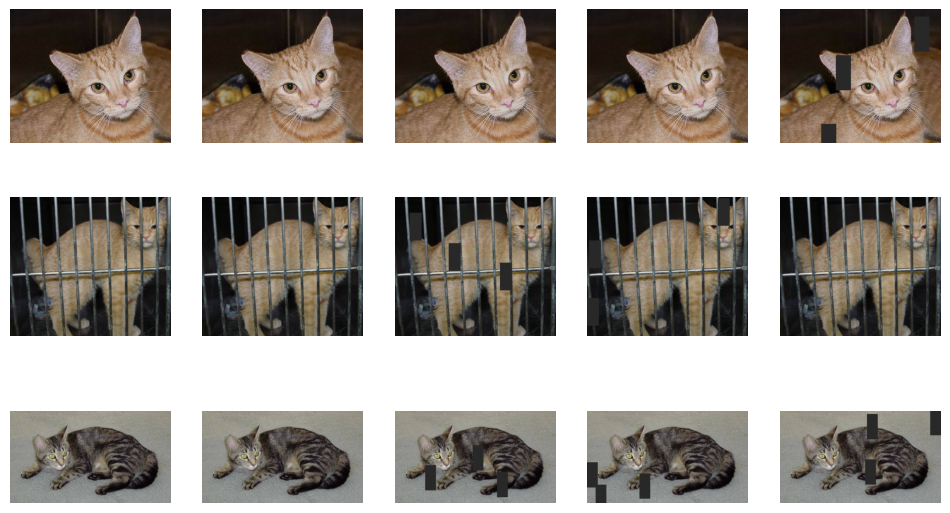

In [28]:
transform = A.Cutout(num_holes=3,max_h_size=70,max_w_size=30,fill_value=40,p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



## Geometric
### Geometric transformations are very good solutions for positional biases present in the training data.
### it changes the angles that objects appear in your dataset during training. Perhaps, during the image collection process, images were only collected with an object horizontally, but in production, the object could be skewed in either direction.
### like rotation, scaling, and translation
### Docs: https://albumentations.ai/docs/api_reference/augmentations/geometric/

### Flip

org:


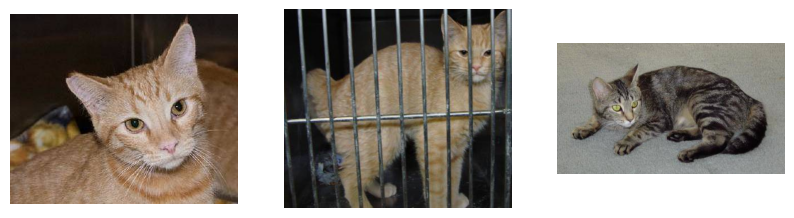

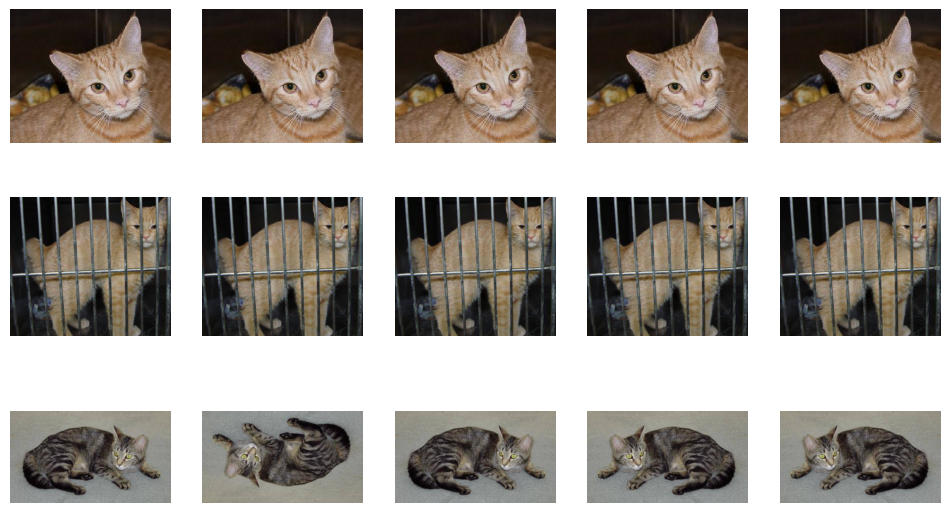

In [29]:
transform = A.Flip(p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### HorzintalFlip

org:


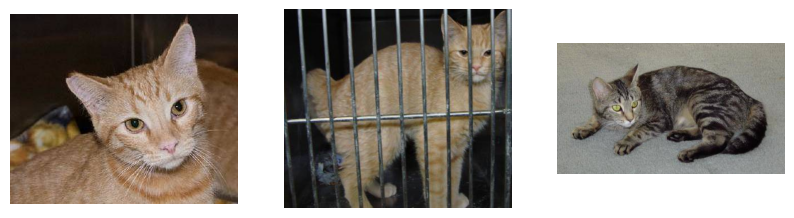

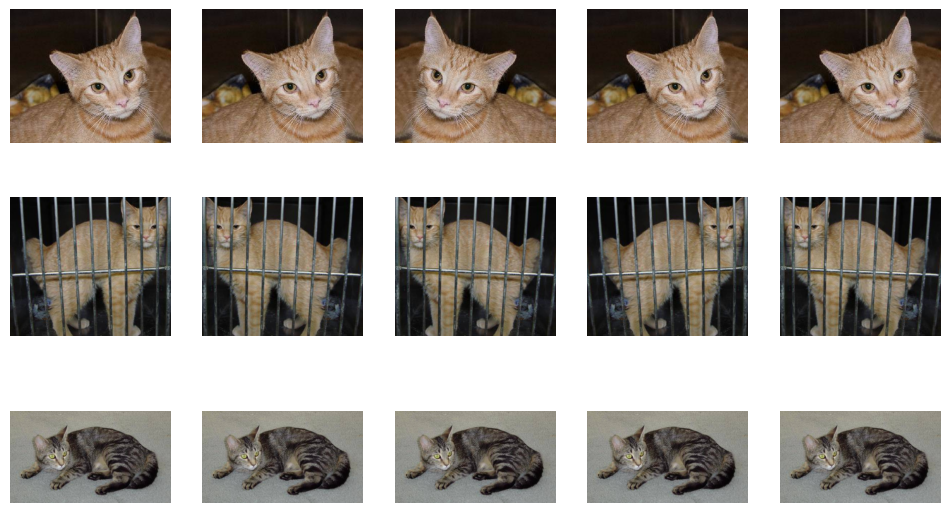

In [30]:
transform = A.HorizontalFlip(p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### perspective

org:


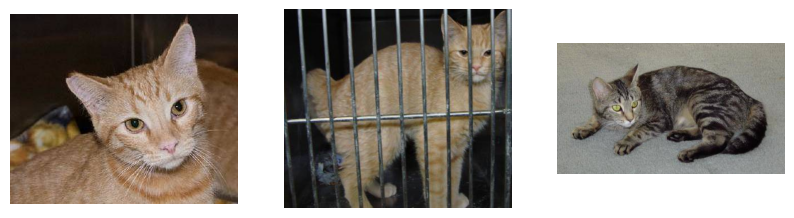

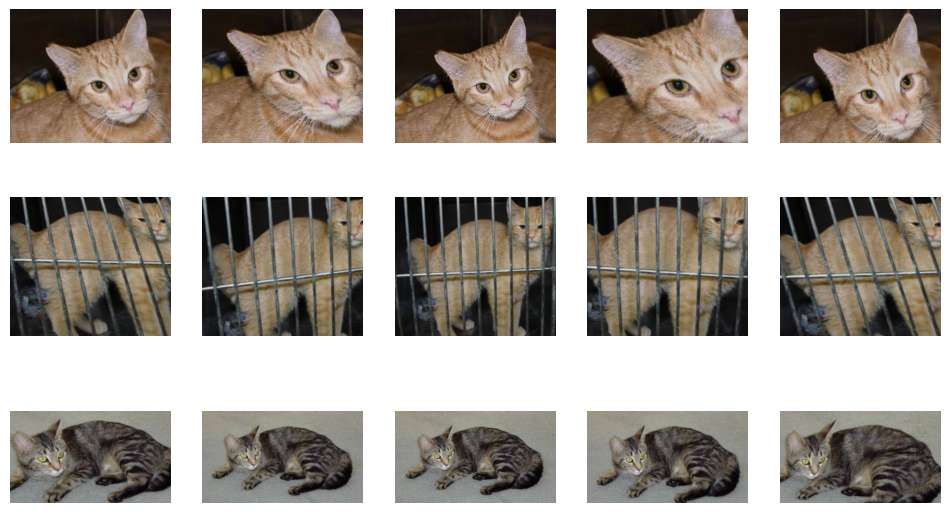

In [31]:
transform = A.Perspective(scale=0.2,p=0.7)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### VerticalFlip

org:


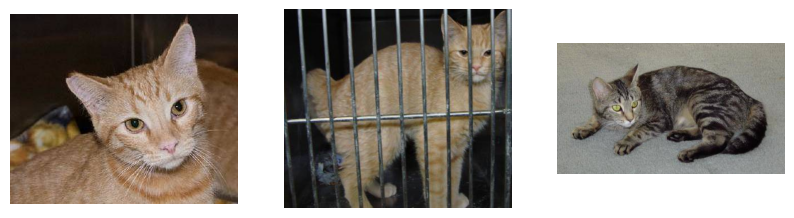

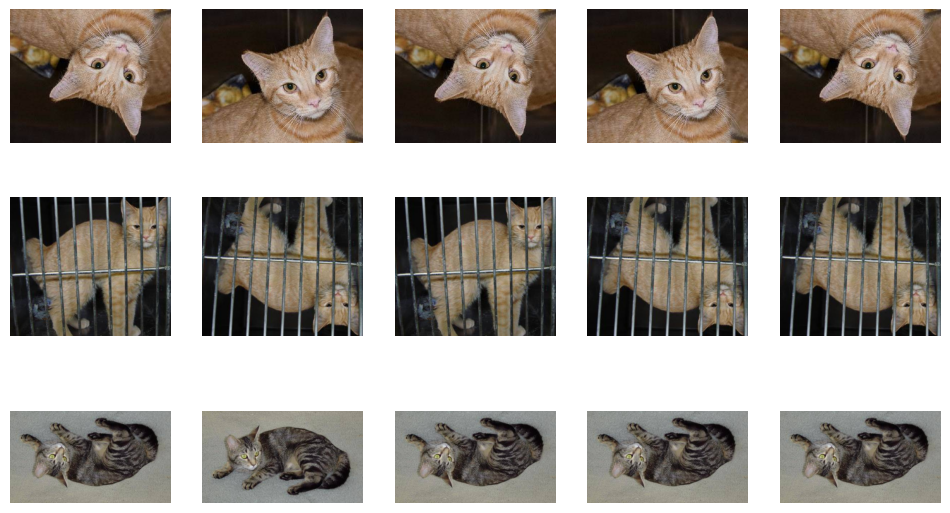

In [32]:
transform = A.VerticalFlip(p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### RandomRotate90

org:


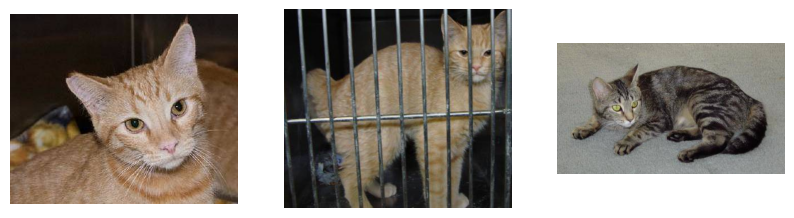

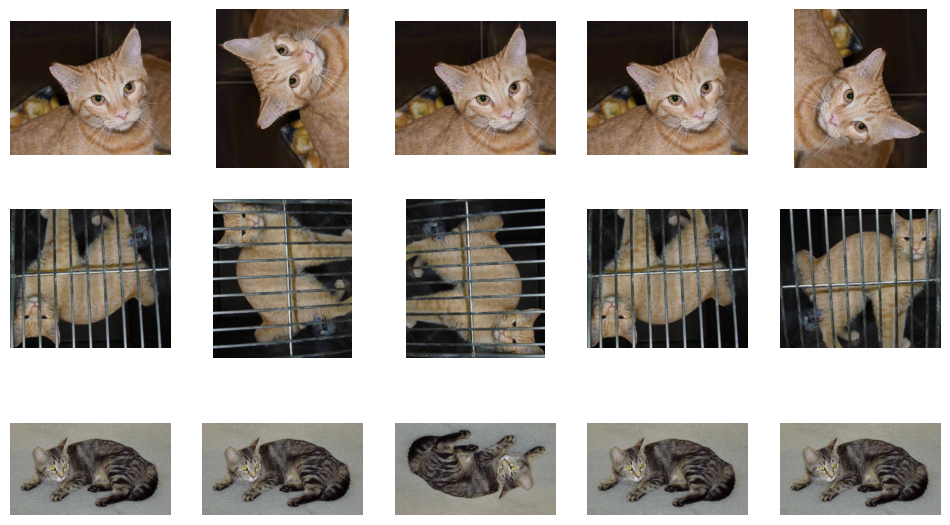

In [33]:
transform = A.RandomRotate90(p=0.4)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### SafeRotate

org:


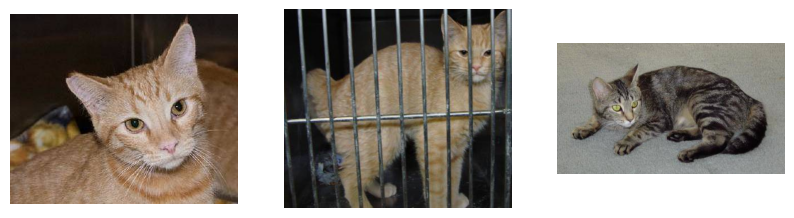

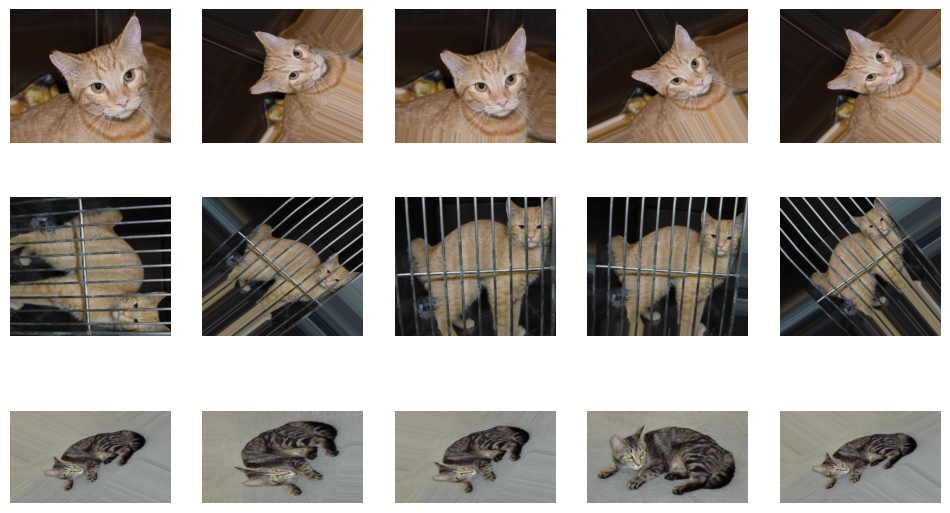

In [34]:
transform = A.SafeRotate(limit=[90,-90],border_mode=cv2.BORDER_REPLICATE,p=0.6)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### RandomScale

org:


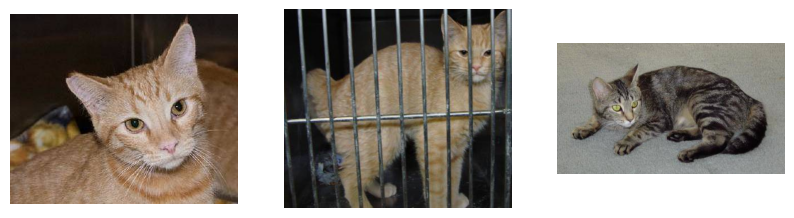

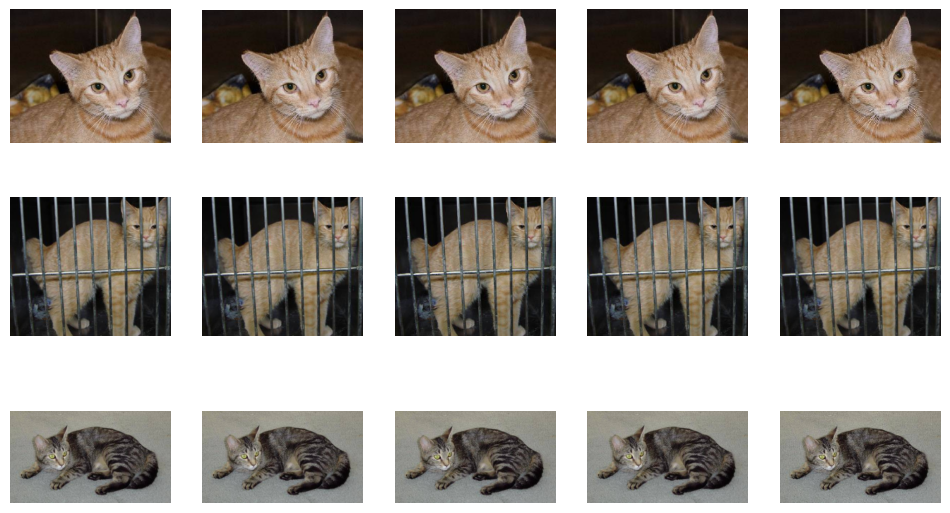

In [35]:
transform = A.RandomScale(scale_limit=0.7,p=0.8)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### Resize

org:


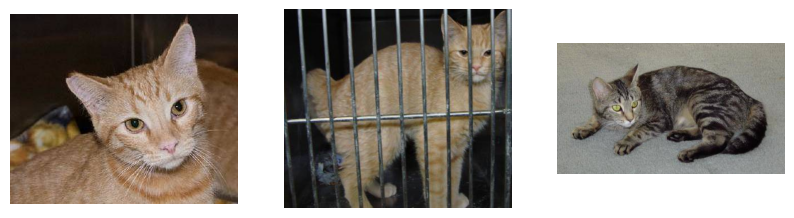

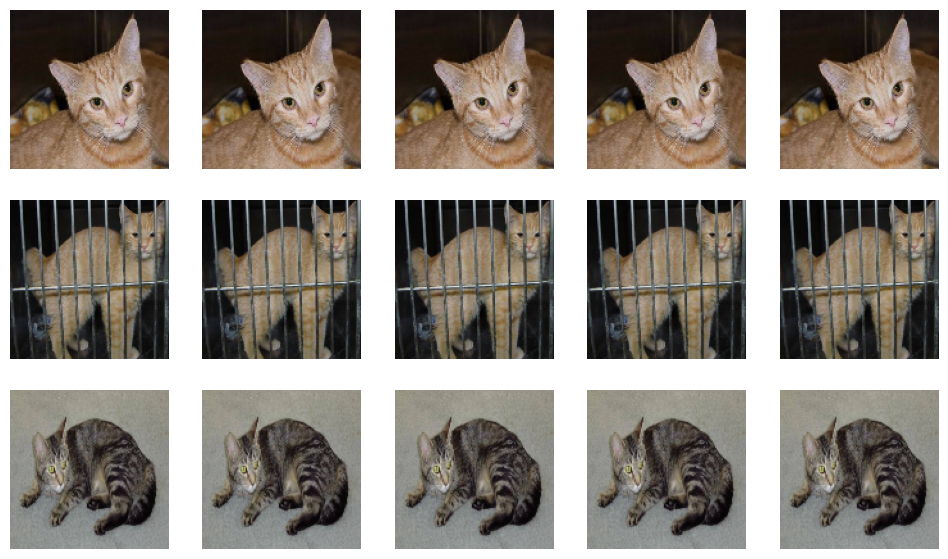

In [36]:
transform = A.Resize(height=124,width=124,always_apply=True)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))



### ChannelShuffle

org:


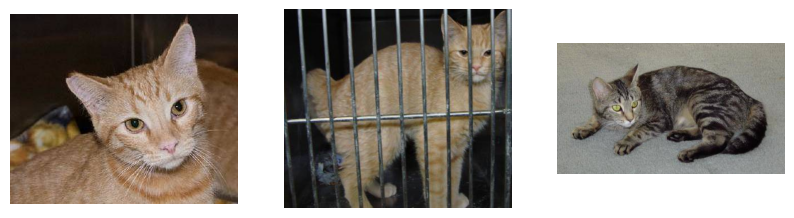

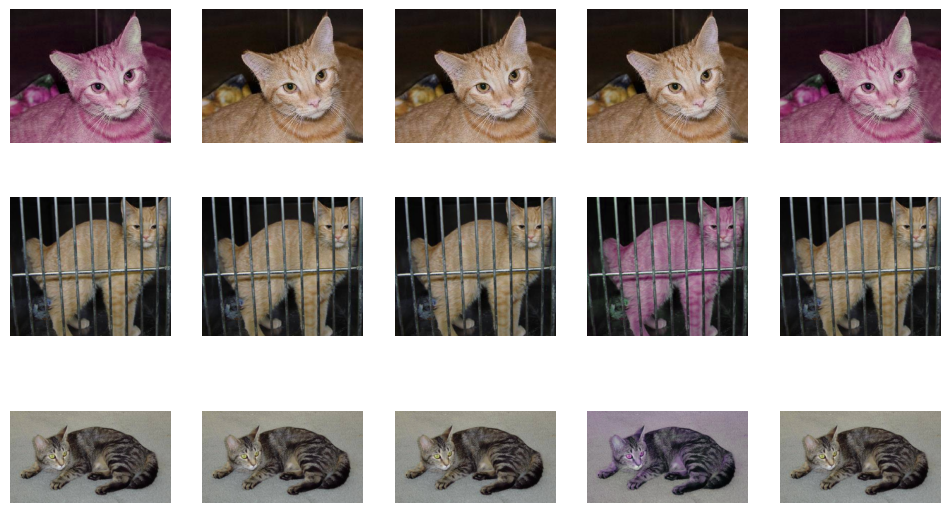

In [37]:
transform = A.ChannelShuffle(p=0.5)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


## Other Transformations 
### Docs: https://albumentations.ai/docs/api_reference/augmentations/transforms/
### https://albumentations.ai/docs/api_reference/augmentations/functional/

### CLAHE

org:


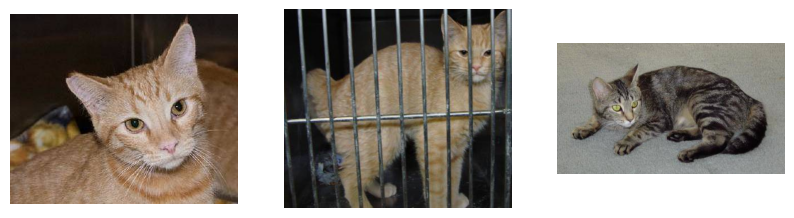

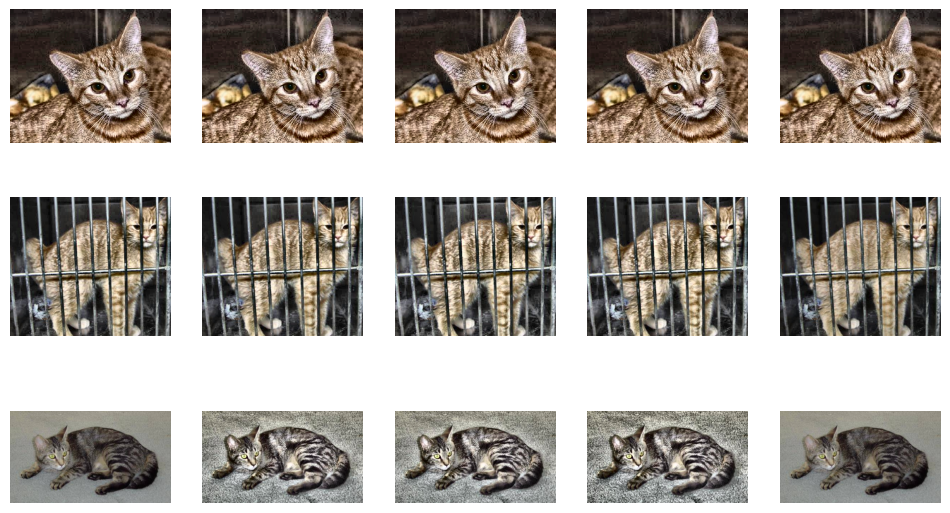

In [38]:
transform = A.CLAHE([1,10],p=0.8)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


org:


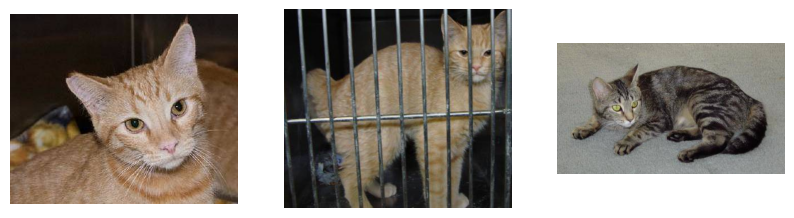

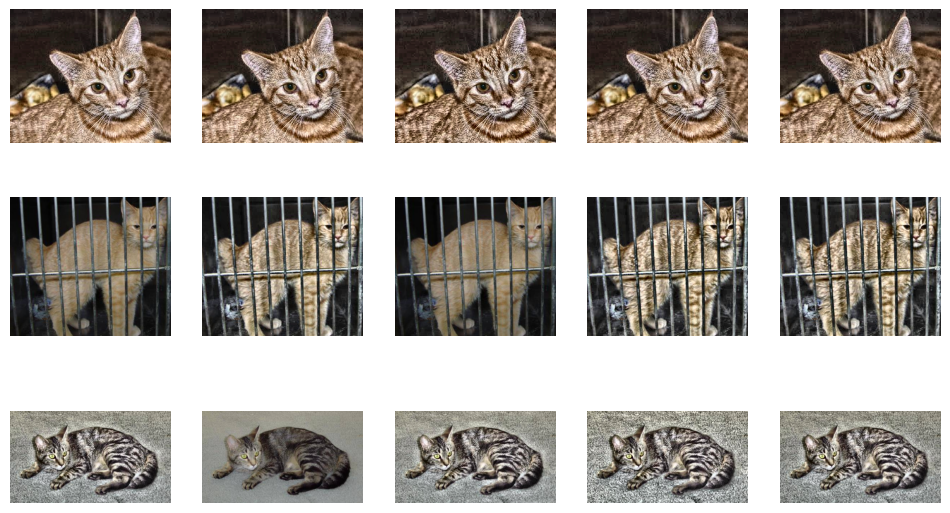

In [39]:
transform = A.CLAHE([1,10],(15,15),p=0.8)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### ColorJitter

org:


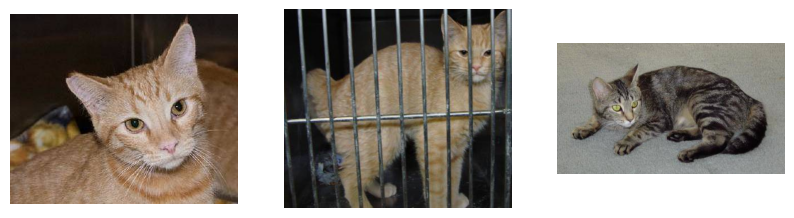

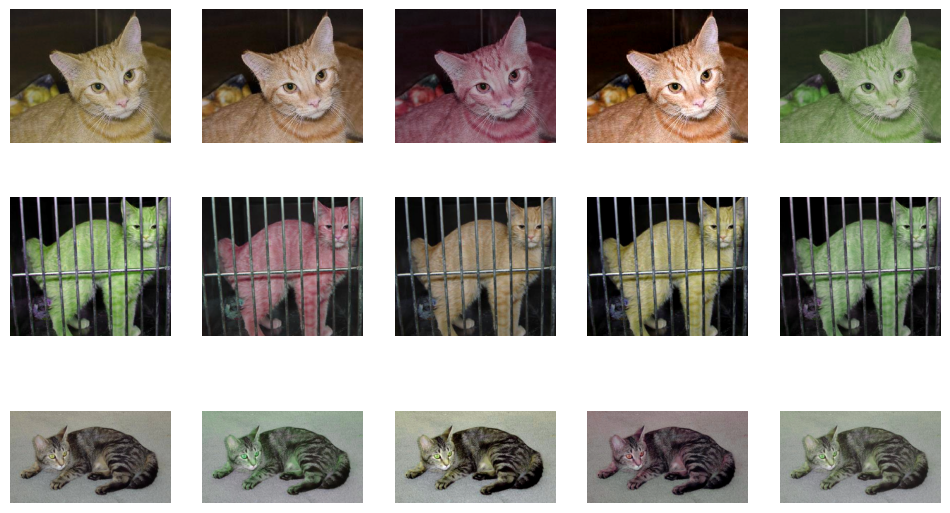

In [40]:
transform = A.ColorJitter(p=0.8)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### Downscale

c:\Users\Hassan\AppData\Local\Programs\Python\Python38\lib\site-packages\albumentations\augmentations\transforms.py:1692: UserWarning: Using default interpolation INTER_NEAREST, which is sub-optimal.Please specify interpolation mode for downscale and upscale explicitly.For additional information see this PR https://github.com/albumentations-team/albumentations/pull/584
  warnings.warn(


org:


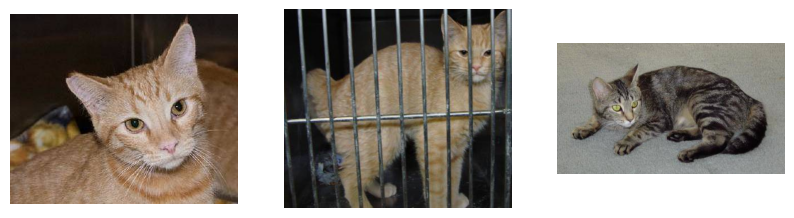

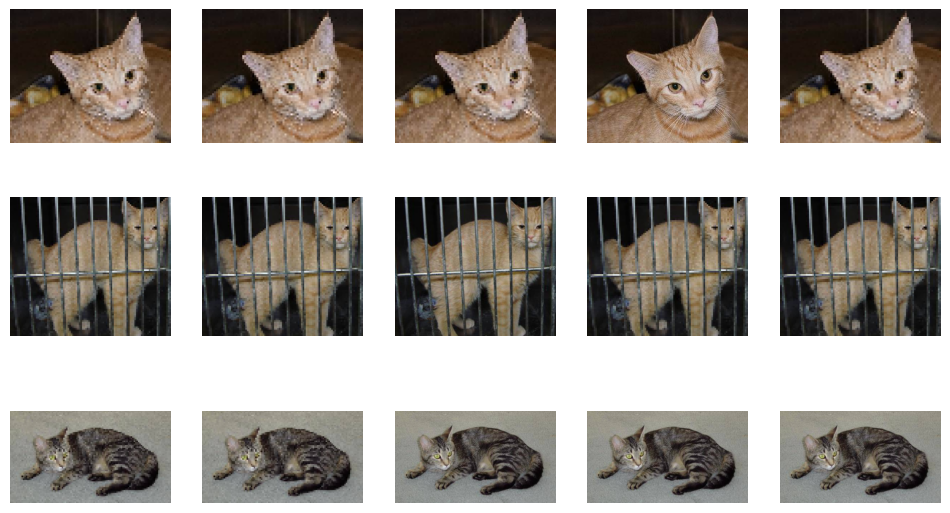

In [41]:
transform = A.Downscale(p=0.8)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### GaussNoise

org:


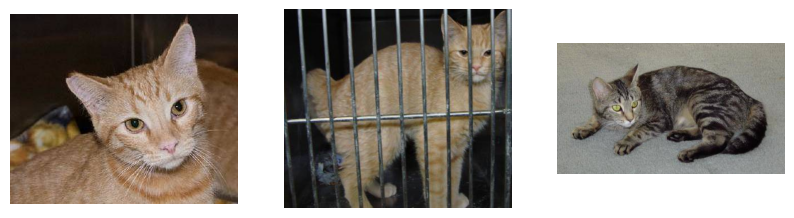

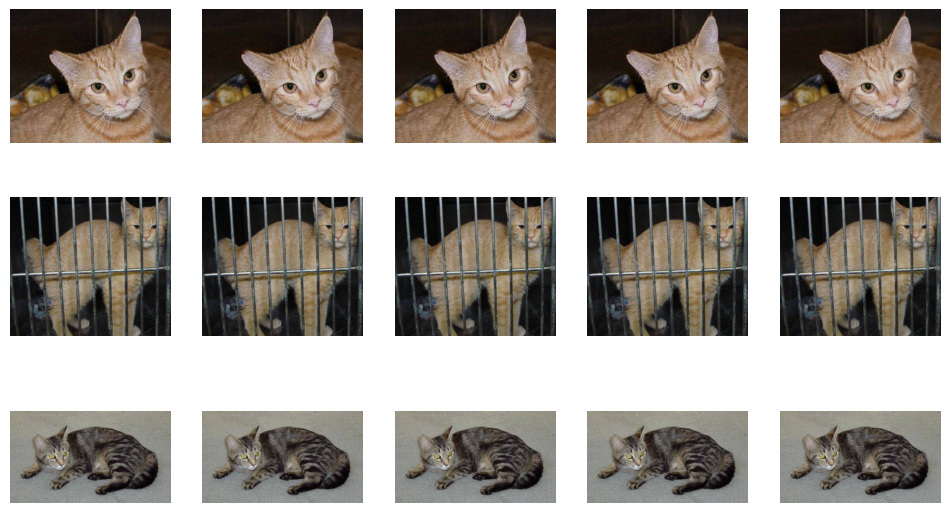

In [42]:
transform = A.GaussNoise(always_apply=True)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


### Normalize

org:


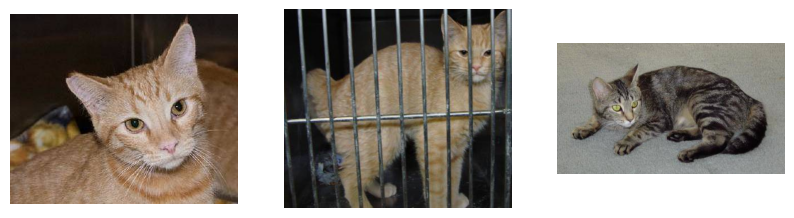

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

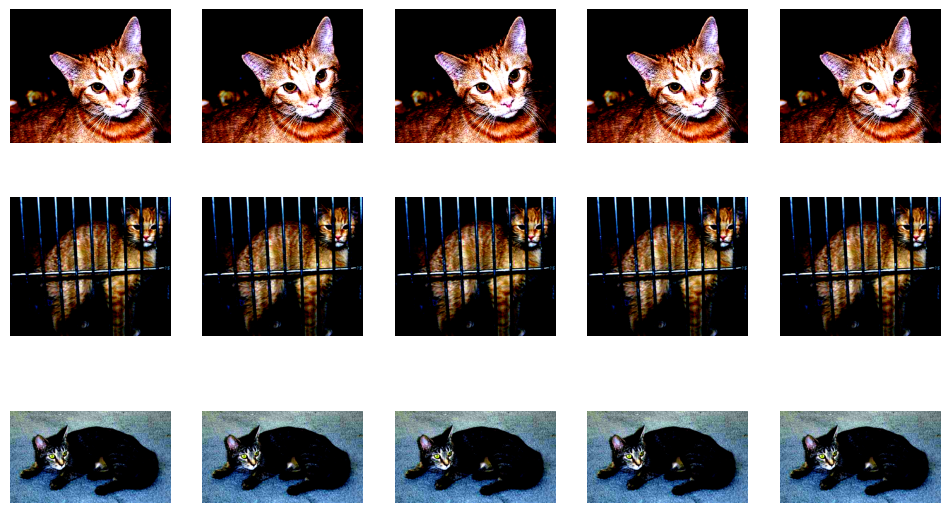

In [43]:
transform = A.Normalize(always_apply=True)
imgs=apply_transform_multi(transform)
print('org:')
visualize_multi_images(1,len(imgs_org),imgs_org)
visualize_multi_images(len(imgs_org),5,imgs,(12,7))


## Albumentaions with Pytorch

In [44]:
import torch,torchvision
import numpy
#from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2


In [45]:
train_path='dataset/training/'
test_path='dataset/testing/'


### define 'train_transforms' 'test_transforms' functions to apply transforms on dataset

In [46]:
def train_transforms(image_):
    # convert from PIL to numpy array (Albumentation work with numpy array)
    image_=numpy.array(image_)
    transform=A.Compose([
        A.Resize(224,224),
        A.RandomResizedCrop(224,224,p=0.5),
        A.HorizontalFlip(p=0.5),
        #torchvision.transforms.ToTensor(),
        ToTensorV2(),

    ])

    aug=transform(image=image_)['image']
    #aug=Image.fromarray(aug['image'])
    return aug

In [47]:
def test_transforms(image_):
    image_=numpy.array(image_)
    transform=A.Compose(
    [
        A.Resize(224,224),
        #torchvision.transforms.ToTensor(),
        ToTensorV2(),
    ]
)
    aug=transform(image=image_)['image']
    return aug

### create train and test pytorch dataset 

In [48]:
train_dataset = torchvision.datasets.ImageFolder(train_path,transform=train_transforms)
test_dataset = torchvision.datasets.ImageFolder(test_path,transform=test_transforms)

In [49]:
train_dataset.imgs[0]

('dataset/training/cat\\cat.1.jpg', 0)

### define train and test dataloader

In [50]:
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=10, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_transforms, batch_size=1)

### visualize 2 batchs

In [51]:
imgs=[]
labels=[]
train_dataloader_it=iter(train_dataloader)
for i in range(2):
    batch=next(train_dataloader_it)
    print(batch[0].shape)
    for img,lb in zip(batch[0],batch[1]):
        img=img.permute(1, 2, 0)
        imgs.append(img)
        labels.append(lb)


torch.Size([10, 3, 224, 224])
torch.Size([10, 3, 224, 224])


### convert idx labels to classes

In [52]:
dic_classtoidx=train_dataset.class_to_idx
labels_=[list(dic_classtoidx.keys())[list(dic_classtoidx.values()).index(lb)] for lb in labels]

### visualize

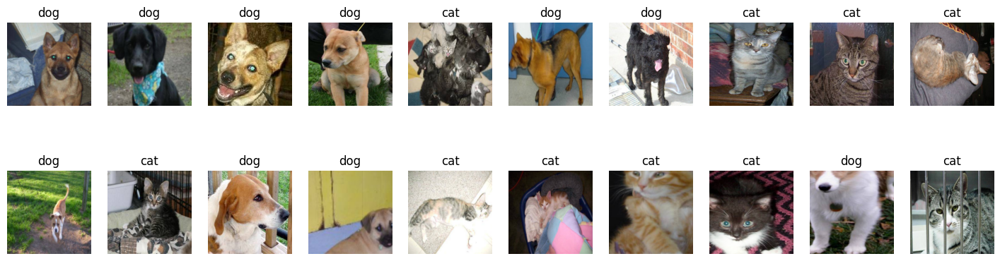

In [53]:
visualize_multi_images(2,10,imgs,(18,5),labels_)